In [1]:
import folium
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from math import ceil
from scipy.signal import find_peaks
import plotly.express as px

In [2]:
df = pd.read_csv("data/p2-arbres-fr.csv", sep=";",)
df_arbres = df
df_arbres.keys()
df_arbres.stade_developpement.replace({
    'J' :'Jeune', 
    'JA':'Jeune Adulte', 
    'A' :'Adulte', 
    'M' :'Mature',
}, inplace=True)

def format_data(row):
    output = f"""- lieu : {str(row['lieu'])}\n
                 - type : {str(row['libelle_francais'])}\n
                 - genres : {str(row['genre'])}
                 - espece : {str(row['espece'])}\n
                 - variete : {str(row['variete'])}\n
                 - circonference_cm : {str(row['circonference_cm'])}\n
                 - hauteur_m : {str(row['hauteur_m'])}\n
                 - stade_developpement : {str(row['stade_developpement'])}"""
    return(output)



In [3]:
df_arbres.type_emplacement.value_counts()

Arbre    200137
Name: type_emplacement, dtype: int64

In [4]:
df_arbres.domanialite.value_counts()

Alignement      104949
Jardin           46262
CIMETIERE        31926
DASCO             6422
PERIPHERIQUE      5327
DJS               3900
DFPE              1325
DAC                 21
DASES                4
Name: domanialite, dtype: int64

In [5]:
df_arbres.arrondissement.value_counts()

PARIS 15E ARRDT      17151
PARIS 13E ARRDT      16712
PARIS 16E ARRDT      16403
PARIS 20E ARRDT      15340
PARIS 19E ARRDT      13709
PARIS 12E ARRDT      12600
SEINE-SAINT-DENIS    11570
BOIS DE VINCENNES    11510
PARIS 14E ARRDT      11399
PARIS 17E ARRDT      10762
PARIS 18E ARRDT      10011
PARIS 7E ARRDT        8617
VAL-DE-MARNE          7580
PARIS 8E ARRDT        7245
PARIS 11E ARRDT       5658
HAUTS-DE-SEINE        5298
BOIS DE BOULOGNE      3978
PARIS 10E ARRDT       3385
PARIS 4E ARRDT        2740
PARIS 5E ARRDT        2368
PARIS 6E ARRDT        1764
PARIS 1ER ARRDT       1413
PARIS 3E ARRDT        1209
PARIS 9E ARRDT        1167
PARIS 2E ARRDT         548
Name: arrondissement, dtype: int64

In [6]:
df_arbres.complement_addresse.value_counts()

SN°           557
1             552
2             547
3             498
4             464
             ... 
F 10-12         1
F 99            1
93 Flandre      1
F 97            1
40face          1
Name: complement_addresse, Length: 3795, dtype: int64

In [7]:
df_arbres.numero.value_counts()

Series([], Name: numero, dtype: int64)

In [8]:
df_arbres.lieu.value_counts()

PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE                       2995
PARC DES BUTTES CHAUMONT                                          2331
PARC ANDRE CITROEN                                                2095
PARC OMNISPORT SUZANNE LENGLEN / 7 BOULEVARD DES FRERES VOISIN    1478
INSEP / AVENUE DU TREMBLAY                                        1293
                                                                  ... 
CIMETIERE ST VINCENT / DIV 5                                         1
ROUTE DU LAC A BAGATELLE                                             1
ROUTE DE LA PORTE SAINT-JAMES                                        1
PENTE DE GRAVELLE - AVENUE DE GRAVELLE / ROUTE NOUVELLE              1
CIMETIERE DE PANTIN / DIV 66                                         1
Name: lieu, Length: 6921, dtype: int64

In [9]:
df_arbres.id_emplacement.value_counts()

101001          1324
101002          1241
101003          1128
202001          1032
101004          1020
                ... 
A15100096004       1
A15100096003       1
A15100096002       1
A15100096001       1
720170155          1
Name: id_emplacement, Length: 69040, dtype: int64

In [10]:
df_arbres.libelle_francais.value_counts()

Platane       42508
Marronnier    25207
Tilleul       21305
Erable        18389
Sophora       11797
              ...  
Cordyline         1
Camphrier         1
Jujubier          1
Maackie           1
Garrya            1
Name: libelle_francais, Length: 192, dtype: int64

In [11]:
df_arbres.genre.value_counts()

Platanus        42591
Aesculus        25341
Tilia           21550
Acer            18471
Sophora         11830
                ...  
Sycopsis            1
Enkianthus          1
Euscaphis           1
Phyllanthus         1
Washingtonia        1
Name: genre, Length: 175, dtype: int64

In [12]:
df_arbres.espece.value_counts()

x hispanica                  36409
hippocastanum                20039
japonica                     11822
n. sp.                        9063
tomentosa                     8962
                             ...  
polycarpa                        1
x gondouinii                     1
lusitanica subsp.azorica         1
oliveri                          1
delavayi subsp. potaninii        1
Name: espece, Length: 539, dtype: int64

In [13]:
df_arbres.variete.value_counts()

Baumannii'             4538
Briotii'               2827
Euchlora'              2756
Chanticleer'           2595
Fastigiata'            2483
                       ... 
Conspicua'                1
Concordia'                1
Kojou-no-mai'             1
Nizetii'                  1
Grosse Pomme Noire'       1
Name: variete, Length: 436, dtype: int64

In [14]:
df_arbres.hauteur_m.value_counts()

0       39219
10      28632
5       26345
15      17228
8       13628
        ...  
97          1
5155        1
815         1
218         1
157         1
Name: hauteur_m, Length: 143, dtype: int64

In [15]:
df_arbres.circonference_cm.value_counts()

0       25867
20       9711
70       6780
60       6369
80       6206
        ...  
388         1
442         1
608         1
595         1
2130        1
Name: circonference_cm, Length: 531, dtype: int64

In [16]:

df_arbres["stade_developpement"].value_counts()

Adulte          64438
Jeune Adulte    35444
Jeune           26937
Mature           6113
Name: stade_developpement, dtype: int64

In [17]:
df_arbres.remarquable.value_counts()

0.0    136855
1.0       184
Name: remarquable, dtype: int64

In [18]:
df_arbres.geo_point_2d_a.value_counts()

48.833321    2
48.838550    2
48.836862    2
48.758683    2
48.857796    2
            ..
48.839535    1
48.839550    1
48.839390    1
48.839365    1
48.820445    1
Name: geo_point_2d_a, Length: 200107, dtype: int64

In [19]:
df_arbres.geo_point_2d_b.value_counts()

2.299317    2
2.374324    2
2.387348    2
2.311181    2
2.337371    2
           ..
2.279792    1
2.279768    1
2.279918    1
2.279878    1
2.454856    1
Name: geo_point_2d_b, Length: 200114, dtype: int64

Classification et définitions des données

Première Analyse :

In [20]:
# print(df_arbres.isnull().sum())
print(df_arbres.isna().sum())
print("LONGUEUR",len(df_arbres))
df_arbres.nunique()

id                          0
type_emplacement            0
domanialite                 1
arrondissement              0
complement_addresse    169235
numero                 200137
lieu                        0
id_emplacement              0
libelle_francais         1497
genre                      16
espece                   1752
variete                163360
circonference_cm            0
hauteur_m                   0
stade_developpement     67205
remarquable             63098
geo_point_2d_a              0
geo_point_2d_b              0
dtype: int64
LONGUEUR 200137


id                     200137
type_emplacement            1
domanialite                 9
arrondissement             25
complement_addresse      3795
numero                      0
lieu                     6921
id_emplacement          69040
libelle_francais          192
genre                     175
espece                    539
variete                   436
circonference_cm          531
hauteur_m                 143
stade_developpement         4
remarquable                 2
geo_point_2d_a         200107
geo_point_2d_b         200114
dtype: int64

In [21]:
df_dict= df_arbres.isna().sum().to_dict()
df_values = [j/200137 for i,j in df_dict.items()]
fig = px.bar(x=list(df_dict.keys()),
                y=df_values,title="Pourcentage de données manquantes pour chaque colonne",
                labels={
                    "x": "Colonnes de données",
                    "y": "% manquants",
                }
            )
fig.show()

In [22]:
df_arbres.stade_developpement.isna()


0          True
1         False
2         False
3         False
4          True
          ...  
200132     True
200133     True
200134     True
200135     True
200136     True
Name: stade_developpement, Length: 200137, dtype: bool

In [23]:
from folium.plugins import MarkerCluster
nan = df_arbres.stade_developpement.isna()

m = folium.Map(location=[48.86, 2.33], zoom_start=12)

marker_cluster = MarkerCluster().add_to(m)
# tooltip = "Arbre data"
flag = 0
for index, row in df_arbres.iterrows():
    if flag > 5000:
        break
    if nan[index]:
        folium.Marker([row.geo_point_2d_a, row.geo_point_2d_b]
            ).add_to(marker_cluster)
        flag +=1

m

Stade de developpement des arbres par Arrondissement

In [24]:
# fig = px.parallel_categories(df_arbres)
# df_arbres

# df = df_arbres.filter(items=["libelle_francais","genre","espece","variete"])
df = df_arbres.filter(items=["stade_developpement","variete","arrondissement"])
# df = df_arbres.filter(items=["libelle_francais","stade_developpement"])
df
fig = px.parallel_categories(df)
# df_arbres.filter(items=["libelle_francais","genre","espece","variete"])
fig.show()
# df_arbres

In [25]:
fig = px.parallel_categories(df_arbres,
    dimensions=['libelle_francais', 'genre', 'espece', 'variete'],
    title="Classification des variétés d'arbres",
    width=1000,
    height=800,
)
fig.show()

Quels sont les arbres les plus plantés actuellement ?

In [26]:
df_libelle = df_arbres["libelle_francais"].value_counts().dropna()
# type(df_libelle)
list_libelle = []
list_count = []
for index, row in df_libelle.items():
    list_libelle.append(index)
    list_count.append(row)

new_df = pd.DataFrame({"libelle":list_libelle, "count":list_count})
new_df
new_df.loc[new_df['count'] < 3500, 'libelle'] = 'Autres variétés'
fig = px.pie(new_df, values='count', names='libelle', title="Repartition des variétés d'arbres ayant au moins 3500 occurences dans Paris")
fig.show()

Quels sont les arbres "Remarquables" ?

In [27]:
df_arbres[["circonference_cm","hauteur_m"]]
df_arbres_hauteur = df_arbres.sort_values(by=["hauteur_m"])
df_arbres_circonference = df_arbres.sort_values(by=["circonference_cm"])

len_df = len(df_arbres)
print("len",len_df)
mediane_rang = (len_df+1)/2
print("mediane_rang",int(round(mediane_rang)))
if int(mediane_rang) % 2 == 0:
    mediane_hauteur = df_arbres_hauteur.iloc[mediane_rang]
    mediane_circonference = df_arbres_circonference.iloc[mediane_rang]
else:
    mediane_hauteur = int((df_arbres_hauteur["hauteur_m"].iloc[round(mediane_rang)]+df_arbres_hauteur["hauteur_m"].iloc[round(mediane_rang)+1]))/2
    mediane_circonference = int((df_arbres_circonference["circonference_cm"].iloc[round(mediane_rang)]+df_arbres_circonference["circonference_cm"].iloc[round(mediane_rang)+1]))/2

quartile_1_hauteur = df_arbres_hauteur["hauteur_m"].iloc[ceil(len_df / 4)]
quartile_3_hauteur = df_arbres_hauteur["hauteur_m"].iloc[ceil(len_df * (3/4))]

quartile_1_circonference = df_arbres_circonference["circonference_cm"].iloc[ceil(len_df / 4)]
quartile_3_circonference = df_arbres_circonference["circonference_cm"].iloc[ceil(len_df * (3/4))]



print("quartile_1_hauteur",quartile_1_hauteur)
print("mediane_hauteur",mediane_hauteur)
print("quartile_3_hauteur",quartile_3_hauteur)
# print(df_arbres["circonference_cm"].last)
print("quartile_1_circonference",quartile_1_circonference)
print("mediane_circonference",mediane_circonference)
print("quartile_3_circonference",quartile_3_circonference)
# df_arbres
# print(quartile_3_hauteur - quartile_1_hauteur)
# print(quartile_1_hauteur - ( 1.5 * quartile_3_hauteur - quartile_1_hauteur))
# print(quartile_3_hauteur + ( 1.5 * quartile_3_hauteur - quartile_1_hauteur))

len 200137
mediane_rang 100069
quartile_1_hauteur 5
mediane_hauteur 8.0
quartile_3_hauteur 12
quartile_1_circonference 30
mediane_circonference 70.0
quartile_3_circonference 115


En triant par hauteur

In [28]:
df_arbres_without_outliers_hauteur = df_arbres[(df_arbres["hauteur_m"] >0) & (df_arbres["hauteur_m"] < 45)]
df_arbres_without_outliers_hauteur = df_arbres_without_outliers_hauteur.sort_values(by=["hauteur_m"],ascending=False)
df_arbres_without_outliers_hauteur

df_arbres_without_outliers_circonference = df_arbres[(df_arbres["circonference_cm"] >0) & (df_arbres["circonference_cm"] < 725)]
df_without_outliers = df_arbres_without_outliers_hauteur.merge(df_arbres_without_outliers_circonference, how='inner')

df_without_outliers = df_without_outliers[df_without_outliers.remarquable == 1.0]
df_without_outliers
m = folium.Map(location=[48.85, 2.320], zoom_start=12, tiles="Stamen Terrain")
tooltip = "Clique pour avoir des infos sur l'arbre"
for index, row in df_without_outliers.head(10).iterrows():
    folium.Marker(
        [row["geo_point_2d_a"], row["geo_point_2d_b"]], popup=format_data(row), tooltip=tooltip
    ).add_to(m)
m

En triant les arbres remarquables par circonférence puis par hauteur.

In [29]:
df_without_outliers = df_without_outliers.sort_values(["circonference_cm","hauteur_m"], ascending=[False, False])
df_without_outliers
m = folium.Map(location=[48.85, 2.320], zoom_start=12, tiles="Stamen Terrain")
tooltip = "Clique pour avoir des infos sur l'arbre"
for index, row in df_without_outliers.head(10).iterrows():
    folium.Marker(
        [row["geo_point_2d_a"], row["geo_point_2d_b"]], popup=format_data(row), tooltip=tooltip
    ).add_to(m)
m

Quels arbres ont un développement anormal ?

In [30]:
# df = px.data.gapminder()

fig = px.scatter(df_without_outliers, x="circonference_cm", y="hauteur_m",
	             color="stade_developpement",
                 hover_name="circonference_cm", log_x=True, size_max=60,title="Nuage de Point du développement des arbres en fonction de la hauteur par la circonférence")
fig.show()

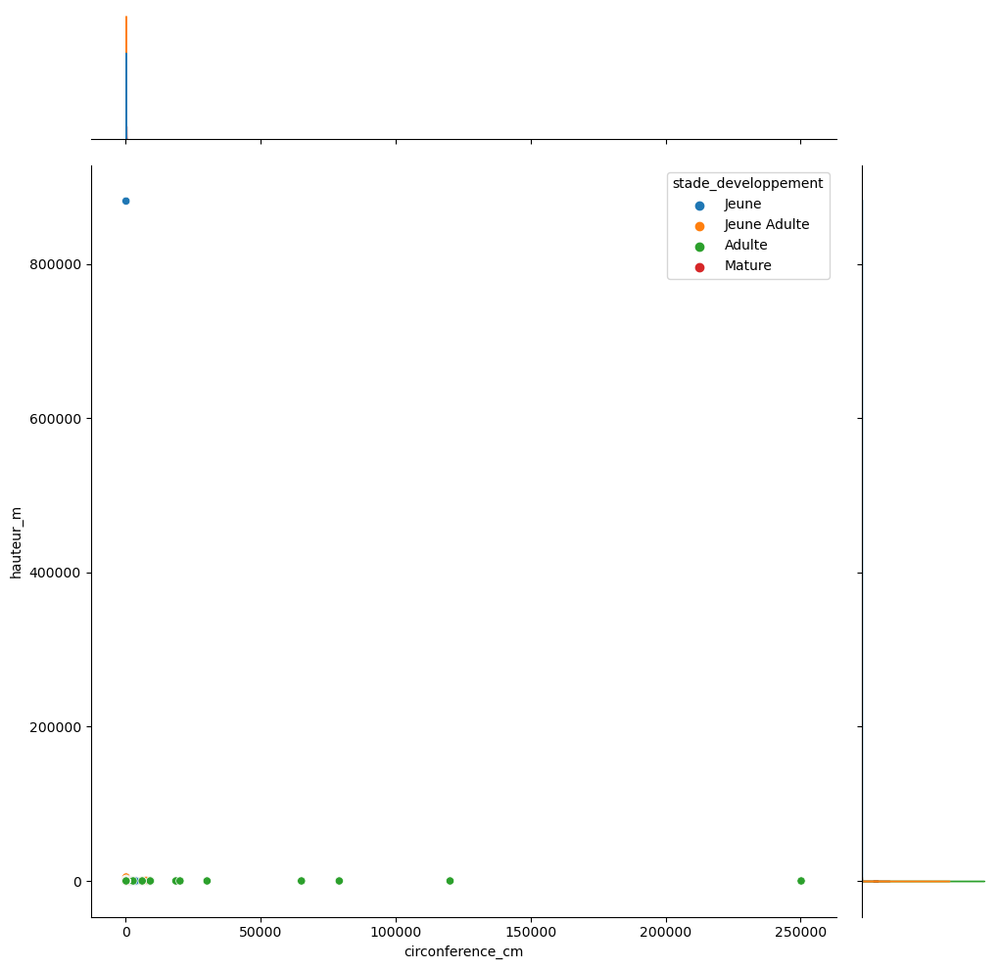

In [33]:
# Let's remove empty values
clean_data_dropna = df_without_outliers.dropna(subset=['circonference_cm', 'hauteur_m', 'stade_developpement'])

sns.jointplot(data=clean_data_dropna,
    x="circonference_cm",
    y="hauteur_m",
    hue="stade_developpement",
    hue_order=['Jeune', 'Jeune Adulte', 'Adulte', 'Mature'],
    height=10,
)